In [1]:
import os
import pickle
from pathlib import Path
import pickle
import re
import pandas as pd
import numpy as np
import matplotlib as mpl
from matplotlib import rcParams
import matplotlib.pyplot as plt
import h5py
import scipy
from scipy import signal
from tqdm import tnrange
from tqdm import tqdm
import seaborn as sns
from scipy.stats import norm,entropy,linregress
from scipy.optimize import minimize, curve_fit
from scipy.io import savemat
from scipy.special import erf
from sklearn.linear_model import LogisticRegression
from joblib import Parallel, delayed

from scipy.stats import norm,entropy,linregress
from scipy.optimize import minimize, curve_fit
from scipy.io import savemat
from scipy.special import erf

#import multiprocess as mp
#from multiprocess import Pool
import sys
import warnings

from odor_breathing_functions import*
from functions_beh import*
from data_loader import*
from hdf5_loader_and_aux_functions import*


warnings.filterwarnings('ignore')

cmap = plt.rcParams['axes.prop_cycle'].by_key()['color']
modulename = 'multiprocess'
mpl.rcParams['svg.fonttype'] = 'none'
sns.set_context('poster', font_scale=1.1)

In [5]:
config = LoaderConfig(
    root_dir=os.getcwd()+"/Session/",
    animals=['Banner', 'Natasha', 'Stark'],#, 'Peterparker'],
    date_range=(20220128,20220327),
    load_sniff=True,
    #load_spikes=False,
    load_breathing=True,
    filters={},
    data_frame=True
)
print(config.root_dir)
learning_data_bns = run_loader(config)

config = LoaderConfig(
    root_dir=os.getcwd()+"/Session/",
    animals=['Peterparker'],#, 'Peterparker'],
    date_range=(20220128,20220408),
    load_sniff=True,
    #load_spikes=False,
    load_breathing=True,
    filters={},
    data_frame=True
)
print(config.root_dir)
learning_data_pp = run_loader(config)

/Users/boero/OEA_Data_Analysis/Session
Loading: Banner | 20220323 | session 0
Loading: Banner | 20220322 | session 0
Loading: Natasha | 20220215 | session 1
Loading: Stark | 20220212 | session 1
Loading: Natasha | 20220223 | session 2
Loading: Stark | 20220224 | session 2
Loading: Stark | 20220225 | session 2
Loading: Natasha | 20220201 | session 0
Loading: Banner | 20220215 | session 0
Loading: Banner | 20220214 | session 0
Loading: Stark | 20220207 | session 0
Loading: Stark | 20220206 | session 0
Loading: Banner | 20220223 | session 3
Loading: Banner | 20220222 | session 3
Loading: Stark | 20220313 | session 2
Loading: Stark | 20220324 | session 1
Loading: Banner | 20220208 | session 2
Loading: Banner | 20220302 | session 1
Loading: Banner | 20220303 | session 1
Loading: Natasha | 20220228 | session 2
Loading: Stark | 20220218 | session 1
Loading: Stark | 20220326 | session 2
Loading: Stark | 20220302 | session 4
Loading: Banner | 20220221 | session 0
Loading: Stark | 20220211 | ses

In [6]:
#learning_dict = learning_data_bns | learning_data_pp
learning_df = pd.concat([learning_data_bns, learning_data_pp], ignore_index=True)
learning_df

,animal_id,date,session,num_trials,trial,sampling_window,type,lambda_1,lambda_2,ratio,...,cum_odor,correct_trial,high_trial,low_trial,high_choice,sniff_hist,sniff_hist_shuffled,pre_breathing,breathing,go_window_duration
0,Banner,20220323,0,99,0,5000,random,12.315271,4.101723,3.0,...,14.0,True,True,False,True,"[0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, ...","[0.0, 0.0, 0.0, 2.0, 1.0, 2.0, 1.0, 1.0, 2.0, ...","[1.5924876772153598, 1.6633904020049142, 1.743...","[1.8351684344460057, 1.838391287770851, 2.0462...",1500
1,Banner,20220323,0,99,1,5000,random,12.315271,4.101723,3.0,...,13.0,True,True,False,True,"[0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, 2.0, 0.0, ...","[1.0, 1.0, 2.0, 0.0, 0.0, 1.0, 2.0, 0.0, 1.0, ...","[4.1604682049731325, 4.121793566474304, 4.0757...","[1.690462355695881, 1.6720921011488628, 1.8177...",1500
2,Banner,20220323,0,99,2,5000,random,12.315271,4.101723,3.0,...,13.0,True,True,False,True,"[1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 2.0, 0.0, 1.0, ...","[0.0, 0.0, 0.0, 1.0, 2.0, 1.0, 0.0, 0.0, 2.0, ...","[1.043636637075352, 1.0900456178517555, 1.1596...","[0.47222649156746627, 0.46932593431826813, 0.4...",1500
3,Banner,20220323,0,99,3,5000,random,12.315271,4.101723,3.0,...,10.0,True,True,False,True,"[0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 2.0, 2.0, ...","[1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, ...","[1.9718174465069376, 2.018548845207145, 2.0958...","[0.4438654880922563, 0.4422540674894877, 0.424...",1500
4,Banner,20220323,0,99,4,5000,random,12.315271,4.101723,3.0,...,14.0,True,True,False,True,"[1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 1.0, ...","[2.0, 0.0, 1.0, 0.0, 2.0, 0.0, 0.0, 1.0, 1.0, ...","[2.0324071235454353, 2.0607682534384484, 2.079...","[4.249419905381219, 4.242651839647951, 4.19946...",1500
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
36744,Peterparker,20220212,0,143,138,1000,block,16.129032,1.001001,16.0,...,17.0,True,True,False,True,"[0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 2.0, 1.0, ...","[2.0, 0.0, 0.0, 2.0, 0.0, 0.0, 1.0, 1.0, 2.0, ...","[0.21697751723642186, 0.15961097164243393, 0.1...","[0.43613066924697297, 0.2959370982106999, 0.41...",1500
36745,Peterparker,20220212,0,143,139,1000,block,16.129032,1.001001,16.0,...,16.0,True,True,False,True,"[1.0, 0.0, 2.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...","[2.0, 1.0, 4.0, 1.0, 1.0, 0.0, 0.0, 0.0, 1.0, ...","[0.3900440427871988, 0.38359836110195933, 0.38...","[0.3942337359266674, 0.39133317913410226, 0.37...",1500
36746,Peterparker,20220212,0,143,140,1000,block,16.129032,1.001001,16.0,...,17.0,True,True,False,True,"[0.0, 0.0, 2.0, 1.0, 3.0, 1.0, 0.0, 3.0, 0.0, ...","[1.0, 2.0, 0.0, 2.0, 2.0, 1.0, 0.0, 0.0, 2.0, ...","[0.44644376106765243, 0.4383866580643271, 0.49...","[3.3872992391153076, 3.389877538225492, 3.4185...",1500
36747,Peterparker,20220212,0,143,141,1000,block,16.129032,1.001001,16.0,...,2.0,False,False,True,True,"[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[3.066623533641679, 3.0617892301812275, 3.0820...","[3.2090743904399748, 3.2180984297893027, 3.547...",1500


In [7]:
learning_df_sorted = learning_df.sort_values(by=['animal_id', 'date', 'session'], ascending=[True, True, True])
learning_df_sorted

,animal_id,date,session,num_trials,trial,sampling_window,type,lambda_1,lambda_2,ratio,...,cum_odor,correct_trial,high_trial,low_trial,high_choice,sniff_hist,sniff_hist_shuffled,pre_breathing,breathing,go_window_duration
9812,Banner,20220128,0,121,0,1000,block,16.129032,1.001001,16.0,...,1.0,True,False,True,False,"[0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[4.67677545268883, 4.692889936555756, 4.698368...","[4.3635101957256595, 4.366733086371598, 4.4824...",1500
9813,Banner,20220128,0,121,1,1000,block,16.129032,1.001001,16.0,...,1.0,False,False,False,True,"[0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[1.7313925758917035, 1.7958496266878363, 1.848...","[3.7717884594610855, 3.775978203652788, 3.7827...",1500
9814,Banner,20220128,0,121,2,1000,block,16.129032,1.001001,16.0,...,2.0,True,False,True,False,"[0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[4.481790322105736, 4.441504166320864, 4.39702...","[2.2757328218433748, 2.2957145445936504, 2.863...",1500
9815,Banner,20220128,0,121,3,1000,block,16.129032,1.001001,16.0,...,2.0,False,False,False,True,"[1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[2.4752278325834776, 2.39981289916821, 2.31021...","[0.550541543915271, 0.5508638281080176, 0.5086...",1500
9816,Banner,20220128,0,121,4,1000,block,16.129032,1.001001,16.0,...,1.0,True,False,True,False,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, ...","[1.0710308264321757, 1.0823107873285482, 1.038...","[0.46288025160412394, 0.4641693881401364, 0.42...",1500
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022,Stark,20220326,2,135,130,5000,random,12.315271,4.101723,3.0,...,2.0,False,False,True,True,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, ...","[0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.45579000071684933, 0.4532117276923954, 0.44...","[0.25790758430108923, 0.2511396202434572, 0.93...",1500
2023,Stark,20220326,2,135,131,5000,random,12.315271,4.101723,3.0,...,14.0,False,True,False,False,"[0.0, 0.0, 1.0, 1.0, 0.0, 1.0, 1.0, 2.0, 1.0, ...","[0.0, 0.0, 1.0, 3.0, 3.0, 0.0, 1.0, 2.0, 0.0, ...","[0.41937189549673926, 0.4164713385588443, 0.41...","[2.1377945185446166, 2.1735682306086326, 2.562...",1500
2024,Stark,20220326,2,135,132,5000,random,12.315271,4.101723,3.0,...,4.0,True,False,True,False,"[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 3.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, ...","[3.9944896065209923, 3.989332992292033, 3.9835...","[0.2511396202434572, 0.2501727682421304, 0.182...",1500
2025,Stark,20220326,2,135,133,5000,random,12.315271,4.101723,3.0,...,5.0,True,False,True,False,"[0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, ...","[1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[1.812286176842865, 1.8271113012867515, 1.7687...","[2.267353390172863, 2.280889395311245, 2.40883...",1500


<AxesSubplot:xlabel='date', ylabel='sampling_window'>

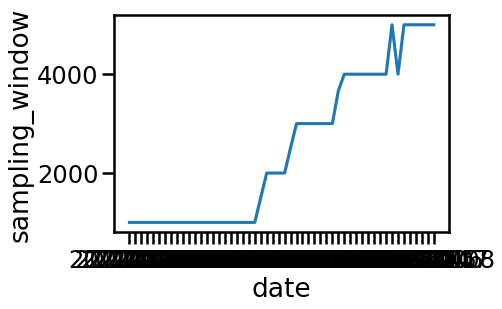

In [11]:
sns.lineplot(data=learning_df_sorted.loc[learning_df_sorted['animal_id']=='Peterparker'], x='date', y='sampling_window')

In [12]:
learning_df.to_pickle('all_trials_learning_df_kyrell.pkl')


In [5]:
learning_df.loc[(learning_df['cum_odor'] > 0) & (learning_df['cum_odor'] < 21)]

,animal_id,date,num_trials,trial,sampling_window,type,ratio,trial_odor,cum_odor,correct_trial,high_trial,low_trial,high_choice,sniff_hist,sniff_hist_shuffled,pre_breathing,breathing,go_window_duration
0,Banner,20220323,99,0,5000,random,3.0,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",14.0,True,True,False,True,"[0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, ...","[1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, ...","[1.5924876772153598, 1.6633904020049142, 1.743...","[1.8351684344460057, 1.838391287770851, 2.0462...",1500
1,Banner,20220323,99,1,5000,random,3.0,"[0.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0...",13.0,True,True,False,True,"[0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, 2.0, 0.0, ...","[1.0, 2.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, ...","[4.1604682049731325, 4.121793566474304, 4.0757...","[1.690462355695881, 1.6720921011488628, 1.8177...",1500
2,Banner,20220323,99,2,5000,random,3.0,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 100.0, 100.0, 1...",13.0,True,True,False,True,"[1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 2.0, 0.0, 1.0, ...","[0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 1.0, 3.0, ...","[1.043636637075352, 1.0900456178517555, 1.1596...","[0.47222649156746627, 0.46932593431826813, 0.4...",1500
3,Banner,20220323,99,3,5000,random,3.0,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",10.0,True,True,False,True,"[0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 2.0, 2.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 2.0, 1.0, 0.0, 0.0, ...","[1.9718174465069376, 2.018548845207145, 2.0958...","[0.4438654880922563, 0.4422540674894877, 0.424...",1500
4,Banner,20220323,99,4,5000,random,3.0,"[0.0, 0.0, 0.0, 100.0, 100.0, 100.0, 100.0, 10...",14.0,True,True,False,True,"[1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 1.0, ...","[1.0, 0.0, 2.0, 2.0, 0.0, 2.0, 1.0, 0.0, 0.0, ...","[2.0324071235454353, 2.0607682534384484, 2.079...","[4.249419905381219, 4.242651839647951, 4.19946...",1500
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
36744,Peterparker,20220212,143,138,1000,block,16.0,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",17.0,True,True,False,True,"[0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 2.0, 1.0, ...","[0.0, 1.0, 0.0, 1.0, 0.0, 1.0, 2.0, 1.0, 1.0, ...","[0.21697751723642186, 0.15961097164243393, 0.1...","[0.43613066924697297, 0.2959370982106999, 0.41...",1500
36745,Peterparker,20220212,143,139,1000,block,16.0,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",16.0,True,True,False,True,"[1.0, 0.0, 2.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...","[1.0, 1.0, 1.0, 1.0, 0.0, 2.0, 0.0, 1.0, 3.0, ...","[0.3900440427871988, 0.38359836110195933, 0.38...","[0.3942337359266674, 0.39133317913410226, 0.37...",1500
36746,Peterparker,20220212,143,140,1000,block,16.0,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",17.0,True,True,False,True,"[0.0, 0.0, 2.0, 1.0, 3.0, 1.0, 0.0, 3.0, 0.0, ...","[1.0, 1.0, 1.0, 2.0, 1.0, 4.0, 2.0, 0.0, 1.0, ...","[0.44644376106765243, 0.4383866580643271, 0.49...","[3.3872992391153076, 3.389877538225492, 3.4185...",1500
36747,Peterparker,20220212,143,141,1000,block,16.0,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",2.0,False,False,True,True,"[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[3.066623533641679, 3.0617892301812275, 3.0820...","[3.2090743904399748, 3.2180984297893027, 3.547...",1500


In [4]:
cum_odor_all, _ = convert_pooled_to_array(learning_dict, "cum_odor", by_animal=False)
sniff_hist_all, _ = convert_pooled_to_array(learning_dict, "sniff_hist", by_animal=False)
sniff_hist_sh_all, _ = convert_pooled_to_array(learning_dict, "sniff_hist_shuffled", by_animal=False)
high_choices_all, _ = convert_pooled_to_array(learning_dict, "high_choices", by_animal=False)

selected_trials = np.logical_and(cum_odor_all>0,cum_odor_all<21).squeeze()
cum_odor_selected = cum_odor_all[selected_trials]
sniff_hist_selected = sniff_hist_all[selected_trials,:]
high_choices_selected = high_choices_all[selected_trials]
sniff_hist_sh_selected = sniff_hist_sh_all[selected_trials]

In [5]:
print(len(cum_odor_selected))

36647


In [7]:
def bootstrap_worker(X, y, random_state=None):
    rng = np.random.default_rng(random_state)
    idx = rng.choice(len(y), len(y), replace=True)
    Xb, yb = X[idx], y[idx]

    model = LogisticRegression(solver='lbfgs', max_iter=1000)
    model.fit(Xb, yb)
    weights = model.coef_[0][:len(Xb)]/model.coef_[0][:len(Xb)].max()
    return weights.ravel()


def bs_logistic(
    X,
    y,
    N_bootstrap=15000,
    n_jobs=-1,
    random_seed=None,
):
    rng = np.random.default_rng(random_seed)
    seeds = rng.integers(0, 1e6, size=N_bootstrap)

    results = Parallel(n_jobs=n_jobs)(
        delayed(bootstrap_worker)(X, y, random_state=s)
        for s in seeds
    )

    all_coefs = np.vstack(results)
    mean_coefs = all_coefs.mean(axis=0)
    std_coefs = all_coefs.std(axis=0)
    ci_low = np.percentile(all_coefs, 2.5, axis=0)
    ci_high = np.percentile(all_coefs, 97.5, axis=0)

    return {
        'all_coefs': all_coefs,
        'mean': mean_coefs,
        'std_coefs': std_coefs,
        'ci_low': ci_low,
        'ci_high': ci_high,
    }

In [8]:
res = bs_logistic(sniff_hist_all, high_choices_all, N_bootstrap=35000)
res_sh = bs_logistic(sniff_hist_sh_all, high_choices_all, N_bootstrap=35000)

/Users/boero/opt/anaconda3/envs/all_behavior/lib/python3.9/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/boero/opt/anaconda3/envs/all_behavior/lib/python3.9/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/boero/opt/anaconda3/envs/all_behavior/lib/python3.9/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/boero/opt/anaconda3/envs/all_behavior/lib/python3.9/site-packages/sklearn/utils/validation.py:1111: DataC

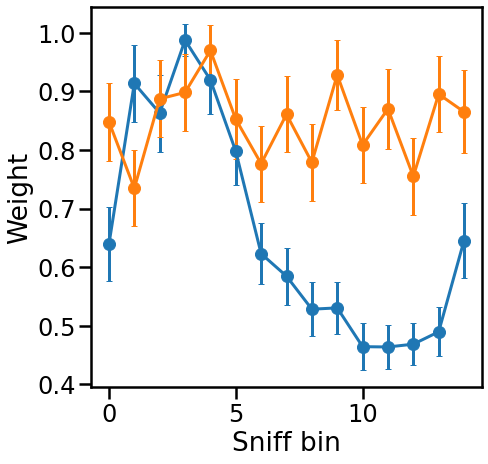

In [9]:
plt.figure(figsize=(7,7))
plt.errorbar(range(sniff_hist_all.shape[1]), res['mean'],
             yerr=res['std_coefs'],
             fmt='-o', capsize=3)
plt.errorbar(range(sniff_hist_sh_all.shape[1]), res_sh['mean'],
             yerr=res_sh['std_coefs'],
             fmt='-o', capsize=3)


plt.xlabel('Sniff bin')
plt.ylabel('Weight')
#plt.title('Bootstrapped Logistic Regression Weights')
plt.show()

In [30]:
mean_trained_weights = np.array([0.6456902 , 0.81551412, 0.9504395 , 0.98746085, 0.83191901,
       0.7612323 , 0.62457731, 0.51303177, 0.42032848, 0.46248978,
       0.45329192, 0.59328354, 0.64584852, 0.55136613, 0.68299045])

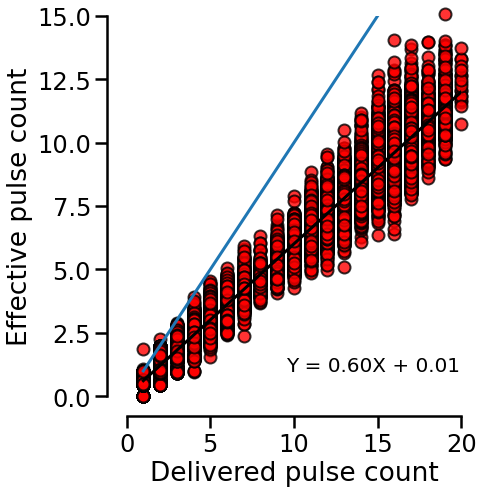

In [10]:
weighted_odor = (sniff_hist_selected*res['mean']).sum(axis=1)
slope, intercept, r_value, p_value, std_err  =  linregress(cum_odor_selected.squeeze(), weighted_odor)
x_fit = np.linspace(1,20,20)
Y_pred_new = x_fit * slope + intercept

plt.figure(figsize=(6,7))
plt.scatter(cum_odor_selected, weighted_odor, marker='o', color='r', edgecolors='k', alpha=.8, clip_on=False)#, vert=False)
plt.plot(x_fit, Y_pred_new, c='k')
plt.plot(x_fit, x_fit)
equation_text = f'Y = {slope:.2f}X + {intercept:.2f}'
plt.text(9.5,1,equation_text, size=20)
plt.xlabel('Delivered pulse count')
plt.ylabel('Effective pulse count')
plt.ylim(0,15)
plt.xlim(0,20)
sns.despine(offset=20)